<a href="https://colab.research.google.com/github/wxzg7045/A-Parallel-Gumbel-Softmax-VAE-Framework-with-Performance-Based-Tuning/blob/main/A_Parallel_Gumbel_Softmax_VAE_Framework_with_Performance_Based_Tuning_on_CelebA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Train Epoch: 0 	Model: 0 	Training Loss: 32336.558469082447
Train Epoch: 0 	Model: 1 	Training Loss: 30922.47137840758
Train Epoch: 0 	Model: 2 	Training Loss: 31110.127908909573
Train Epoch: 0 	Model: 3 	Training Loss: 31039.360964511303
Train Epoch: 0 	Model: 4 	Training Loss: 31418.598996426197
Train Epoch: 1 	Model: 0 	Training Loss: 32152.075216090427
Train Epoch: 1 	Model: 1 	Training Loss: 29155.854814245347
Train Epoch: 1 	Model: 2 	Training Loss: 29332.363748753323
Train Epoch: 1 	Model: 3 	Training Loss: 28846.44924991689
Train Epoch: 1 	Model: 4 	Training Loss: 29705.226198886303
Train Epoch: 2 	Model: 0 	Training Loss: 32139.363364361703
Train Epoch: 2 	Model: 1 	Training Loss: 27877.646089594415
Train Epoch: 2 	Model: 2 	Training Loss: 27992.59596284907
Train Epoch: 2 	Model: 3 	Training Loss: 27737.91386510971
Train Epoch: 2 	Model: 4 	Training Loss: 27973.665911735374
Train Epoch: 3 	Model: 0 	Training Loss: 32136.154681266624
Train Epoch: 3 	Model: 1 	Training Loss: 270

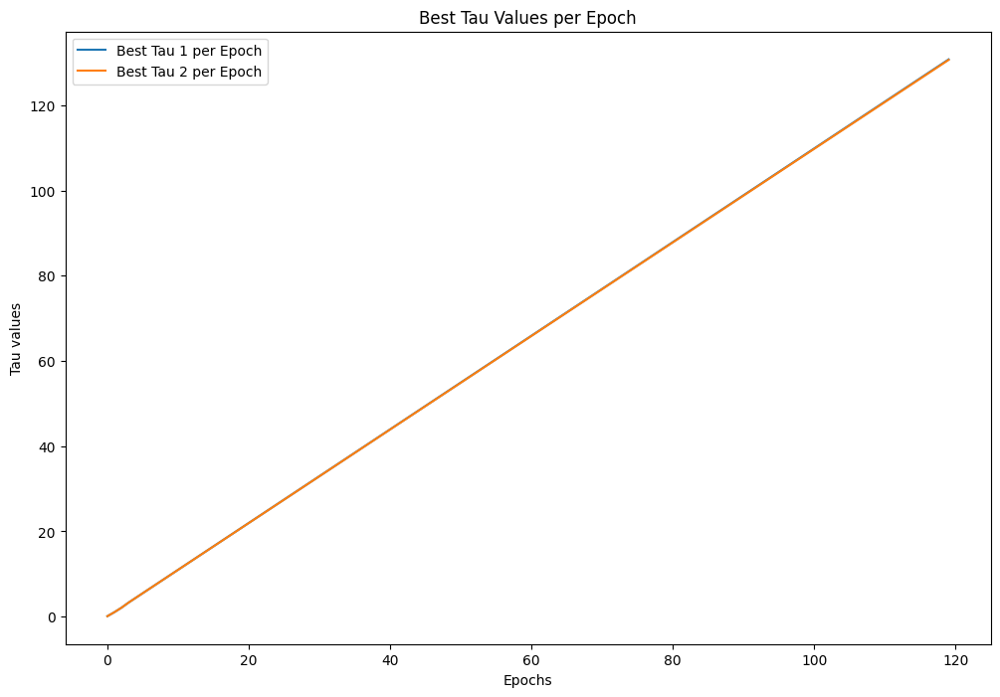

In [ ]:
# Our proposed model 100 epochs training linear operation tau on CelebA HD
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np
import copy
import torch.nn.functional as F
import numpy as np
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils.data.dataloader as dataloader
import torch.optim as optim

from torch.utils.data import TensorDataset
from torch.autograd import Variable
from torchvision import transforms
from torchvision.datasets import CelebA

import torch
from torch import nn
from torch import optim
from torch.utils import data as dataloader
from torchvision import transforms

# Define constants
BATCH_SIZE = 128
Z_DIM = 300
NUM_EPOCHS = 30
LOG_INTERVAL = 50
SAVE_PATH = "model.pth"
DATA_DIR = "/content/sample_data/archive.zip"


class CustomDataset(Dataset):
    def __init__(self, root_zip, transform=None):
        self.root_zip = root_zip
        self.transform = transform
        self.image_paths = self.extract_zip(root_zip)
        random.shuffle(self.image_paths)  # Shuffle the image paths

    def extract_zip(self, root_zip):
        # Extract the ZIP file
        extract_dir = '/content/extracted_images'  # Main directory where the zip is extracted
        sub_dir = 'celeba_hq_256'  # Subdirectory containing the images
        full_extract_dir = os.path.join(extract_dir, sub_dir)  # Full path to the images
        with zipfile.ZipFile(root_zip, 'r') as zip_ref:
            zip_ref.extractall(extract_dir)

        # List image files in the subdirectory
        image_paths = [os.path.join(full_extract_dir, filename)
                       for filename in os.listdir(full_extract_dir)
                       if os.path.isfile(os.path.join(full_extract_dir, filename))]
        return image_paths

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_name = self.image_paths[idx]
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, 0

# Define the directory containing the ZIP file
DATA_DIR = '/content/sample_data/archive.zip'

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])



# Create a custom dataset
custom_dataset = CustomDataset(DATA_DIR, transform=transform)


total_size = len(custom_dataset)
train_size = int(0.8 * total_size)
test_size = total_size - train_size

train_dataset, test_dataset = torch.utils.data.random_split(custom_dataset, [train_size, test_size])


train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)

def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy().squeeze()
    reconstructed_images = reconstructed_images.cpu().detach().numpy().squeeze()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()



# Define the GumbelSoftmaxVAE model
class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau_1=1.0, tau_2=1.0):
        super().__init__()

        self.tau_1 = tau_1
        self.tau_2 = tau_2

        # Encoder
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        # Two layers of latent variables
        self.fc_logits_z1 = nn.Linear(256 * 8 * 8, Z_DIM)  # Modify input size
        self.fc_logits_z2 = nn.Linear(Z_DIM, Z_DIM)

        # Decoder for each layer
        self.fc_dec1 = nn.Linear(Z_DIM, 256 * 8 * 8)  # Modify output size
        self.fc_dec2 = nn.Linear(Z_DIM, 128 * 16 * 16)  # Modify input size

        self.conv_trans1_1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_1 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans4_1 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

        self.conv_trans1_2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_2 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = x.view(x.size(0), -1)

        logits_z1 = self.fc_logits_z1(x)
        logits_z2 = self.fc_logits_z2(logits_z1)

        return logits_z1, logits_z2

    def reparameterize(self, logits, tau):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / tau
        z = F.softmax(z, dim=-1)
        return z

    def decode1(self, z):
        z = self.fc_dec1(z)
        z = z.view(z.size(0), 256, 8, 8)  # reshape to match the new input size
        z = F.relu(self.conv_trans1_1(z))
        z = F.relu(self.conv_trans2_1(z))
        z = F.relu(self.conv_trans3_1(z))
        z = torch.sigmoid(self.conv_trans4_1(z))
        return z

    def decode2(self, z):
        z = self.fc_dec2(z)
        z = z.view(z.size(0), 128, 16, 16)  # reshape to match the new input size
        z = F.relu(self.conv_trans1_2(z))
        z = F.relu(self.conv_trans2_2(z))
        z = torch.sigmoid(self.conv_trans3_2(z))
        return z

    def forward(self, x):
        logits_z1, logits_z2 = self.encode(x)
        z1 = self.reparameterize(logits_z1, self.tau_1)
        z2 = self.reparameterize(logits_z2, self.tau_2)

        x_hat1 = self.decode1(z1)
        x_hat2 = self.decode2(z2)

        # Average the output of the two decoders
        x_hat = (x_hat1 + x_hat2) / 2.0

        return x_hat, logits_z1, logits_z2, z1, z2

    def gumbel_softmax_loss_function(self, recon_x, x, logits_z1, logits_z2, z1, z2):
        # Binary cross entropy
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        # KL divergence for each layer
        p_z1 = F.softmax(logits_z1, dim=-1)
        p_z1 = torch.clamp(p_z1, torch.finfo(p_z1.dtype).eps, 1. - torch.finfo(p_z1.dtype).eps)  # to prevent log(0)
        kl_loss_z1 = torch.sum(p_z1 * torch.log(p_z1 * Z_DIM + torch.finfo(p_z1.dtype).eps), dim=-1)

        p_z2 = F.softmax(logits_z2, dim=-1)
        p_z2 = torch.clamp(p_z2, torch.finfo(p_z2.dtype).eps, 1. - torch.finfo(p_z2.dtype).eps)  # to prevent log(0)
        kl_loss_z2 = torch.sum(p_z2 * torch.log(p_z2 * Z_DIM + torch.finfo(p_z2.dtype).eps), dim=-1)

        # Total loss is the sum of the losses for each layer
        vae_loss = torch.mean(xent_loss + kl_loss_z1 + kl_loss_z2)
        return vae_loss



initial_tau_1 = 1.0
initial_tau_2 = 1.0
NUM_EPOCHS = 120
LOG_INTERVAL = 50
import numpy as np
NUM_MODELS = 5
import copy
LOSS_THRESHOLD = 0.01

# Initialize models and optimizers
models = [GumbelSoftmaxVAE().to(device) for _ in range(NUM_MODELS)]
optimizers = [optim.Adam(model.parameters(), lr=1e-3) for model in models]

# Calculate the decay rates for tau_1 and tau_2 for each model
decay_rates_1 = np.linspace(0.999 - (0.5 / NUM_MODELS), 0.999 + (0.5 / NUM_MODELS), NUM_MODELS)
decay_rates_2 = np.linspace(0.998 - (0.5 / NUM_MODELS), 0.998 + (0.5 / NUM_MODELS), NUM_MODELS)

best_tau_per_epoch_1 = []  # To record the best tau_1 for each epoch
best_tau_per_epoch_2 = []  # To record the best tau_2 for each epoch

for epoch in range(NUM_EPOCHS):
    losses = []
    bpds = []
    best_reconstruction = None  # Keep track of the best reconstruction
    original_images = None

    for i in range(NUM_MODELS):
        models[i].tau_1 = max(initial_tau_1 * (decay_rates_1[i] * epoch), 0.1)  # Different decay strategy for each model's tau_1
        models[i].tau_2 = max(initial_tau_2 * (decay_rates_2[i] * epoch), 0.1)  # Different decay strategy for each model's tau_2

        epoch_loss = 0.0
        epoch_bpd = 0.0

        for batch_idx, (data, _) in enumerate(train_loader):
            data = data.to(device)
            optimizers[i].zero_grad()
            recon_batch, logits_z1, logits_z2, z1, z2 = models[i](data)
            loss = models[i].gumbel_softmax_loss_function(recon_batch, data, logits_z1, logits_z2, z1, z2)
            loss.backward()
            optimizers[i].step()

            epoch_loss += loss.item()



            if epoch_loss < LOSS_THRESHOLD and (best_reconstruction is None or loss.item() < min(losses)):
                best_reconstruction = recon_batch  # Save best reconstruction so far
                original_images = data  # Save the original images for plotting

        # Average loss and BPD over all batches
        epoch_loss /= len(train_loader)


        print(f'Train Epoch: {epoch} \tModel: {i} \tTraining Loss: {epoch_loss}')
        losses.append(epoch_loss)


    # Select the model with the lowest loss and record the tau
    best_model_idx = np.argmin(losses)
    best_tau_per_epoch_1.append(models[best_model_idx].tau_1)
    best_tau_per_epoch_2.append(models[best_model_idx].tau_2)

    # Only copy the best model's parameters to all the other models if its loss is below the threshold
    if min(losses) < LOSS_THRESHOLD:
        best_model_state_dict = copy.deepcopy(models[best_model_idx].state_dict())
        for i in range(NUM_MODELS):
            if i != best_model_idx:
                models[i].load_state_dict(best_model_state_dict)
                # Update the tau values as they are not part of the state_dict
                models[i].tau_1 = models[best_model_idx].tau_1
                models[i].tau_2 = models[best_model_idx].tau_2

    # Display the best reconstruction image along with the original image
    if best_reconstruction is not None and original_images is not None:
        plot_images(original_images.cpu(), best_reconstruction.cpu())

# Output the best tau for each epoch
for epoch, (tau_1, tau_2) in enumerate(zip(best_tau_per_epoch_1, best_tau_per_epoch_2)):
    print(f"Epoch: {epoch}, Best Tau 1: {tau_1}, Best Tau 2: {tau_2}")

# Plot the best_tau_per_epoch
plt.figure(figsize=(12, 8))
plt.plot(range(NUM_EPOCHS), best_tau_per_epoch_1, label='Best Tau 1 per Epoch')
plt.plot(range(NUM_EPOCHS), best_tau_per_epoch_2, label='Best Tau 2 per Epoch')
plt.xlabel('Epochs')
plt.ylabel('Tau values')
plt.title('Best Tau Values per Epoch')
plt.legend()
plt.show()

In [ ]:
# Save our proposed model using the linear increasing temperature from 0.1 to higher temp by 0.9 varying rate on CelebA HD
print(best_tau_per_epoch_1)
print(best_tau_per_epoch_2)
# Save the best model
best_model = models[best_model_idx]
torch.save(best_model.state_dict(), 'best_model_celebA_HDm5.pt')

[0.1, 1.049, 2.098, 3.2969999999999997, 4.396, 5.495, 6.593999999999999, 7.693, 8.792, 9.891, 10.99, 12.089, 13.187999999999999, 14.286999999999999, 15.386, 16.485, 17.584, 18.683, 19.782, 20.881, 21.98, 23.079, 24.178, 25.277, 26.375999999999998, 27.474999999999998, 28.573999999999998, 29.673, 30.772, 31.871, 32.97, 34.069, 35.168, 36.266999999999996, 37.366, 38.464999999999996, 39.564, 40.663, 41.762, 42.861, 43.96, 45.059, 46.158, 47.257, 48.356, 49.455, 50.554, 51.653, 52.751999999999995, 53.851, 54.949999999999996, 56.049, 57.147999999999996, 58.247, 59.346, 60.445, 61.544, 62.643, 63.742, 64.841, 65.94, 67.039, 68.138, 69.237, 70.336, 71.435, 72.53399999999999, 73.633, 74.732, 75.831, 76.92999999999999, 78.029, 79.128, 80.227, 81.326, 82.425, 83.524, 84.623, 85.722, 86.821, 87.92, 89.01899999999999, 90.118, 91.217, 92.316, 93.41499999999999, 94.514, 95.613, 96.712, 97.81099999999999, 98.91, 100.009, 101.108, 102.207, 103.306, 104.405, 105.50399999999999, 106.603, 107.702, 108.801

In [ ]:
# Save our proposed model using the linear increasing temperature from 0.1 to higher temp by 0.4 varying rate
print(best_tau_per_epoch_1)
print(best_tau_per_epoch_2)
# Save the best model
best_model = models[best_model_idx]
torch.save(best_model.state_dict(), 'best_model_celebA_HDm1.pt')

[0.1, 0.499, 0.998, 1.4969999999999999, 1.996, 2.495, 2.9939999999999998, 3.493, 3.992, 4.491, 4.99, 5.489, 5.9879999999999995, 6.487, 6.986, 7.485, 7.984, 8.483, 8.982, 9.481, 9.98, 10.479, 10.978, 11.477, 11.975999999999999, 12.475, 12.974, 13.473, 13.972, 14.471, 14.97, 15.469, 15.968, 16.467, 16.966, 17.465, 17.964, 18.463, 18.962, 19.461, 19.96, 20.459, 20.958, 21.457, 21.956, 22.455, 22.954, 23.453, 23.951999999999998, 24.451]
[0.1, 0.498, 0.996, 1.494, 1.992, 2.49, 2.988, 3.4859999999999998, 3.984, 4.482, 4.98, 5.478, 5.976, 6.474, 6.9719999999999995, 7.47, 7.968, 8.466, 8.964, 9.462, 9.96, 10.458, 10.956, 11.454, 11.952, 12.45, 12.948, 13.446, 13.943999999999999, 14.442, 14.94, 15.438, 15.936, 16.434, 16.932, 17.43, 17.928, 18.426, 18.924, 19.422, 19.92, 20.418, 20.916, 21.414, 21.912, 22.41, 22.908, 23.406, 23.904, 24.402]


In [ ]:
# Load models with different linear increasing temperature path on CelebA HD
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import os
import random
from PIL import Image
import zipfile
import torch.optim as optim
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np
import copy


# Set the random seed and device
SEED = 1
torch.manual_seed(SEED)
cuda = torch.cuda.is_available()
device = torch.device('cuda' if cuda else 'cpu')

# Set the random seed and device
# Define constants
BATCH_SIZE = 128
Z_DIM = 300
NUM_EPOCHS = 30
LOG_INTERVAL = 50
SAVE_PATH = "model.pth"
DATA_DIR = "/content/sample_data/archive.zip"


class CustomDataset(Dataset):
    def __init__(self, root_zip, transform=None):
        self.root_zip = root_zip
        self.transform = transform
        self.image_paths = self.extract_zip(root_zip)
        random.shuffle(self.image_paths)  # Shuffle the image paths

    def extract_zip(self, root_zip):
        # Extract the ZIP file
        extract_dir = '/content/extracted_images'  # Main directory where the zip is extracted
        sub_dir = 'celeba_hq_256'  # Subdirectory containing the images
        full_extract_dir = os.path.join(extract_dir, sub_dir)  # Full path to the images
        with zipfile.ZipFile(root_zip, 'r') as zip_ref:
            zip_ref.extractall(extract_dir)

        # List image files in the subdirectory
        image_paths = [os.path.join(full_extract_dir, filename)
                       for filename in os.listdir(full_extract_dir)
                       if os.path.isfile(os.path.join(full_extract_dir, filename))]
        return image_paths

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_name = self.image_paths[idx]
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, 0

# Define the directory containing the ZIP file
DATA_DIR = '/content/sample_data/archive.zip'

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])



# Create a custom dataset
custom_dataset = CustomDataset(DATA_DIR, transform=transform)


total_size = len(custom_dataset)
train_size = int(0.8 * total_size)
test_size = total_size - train_size

train_dataset, test_dataset = torch.utils.data.random_split(custom_dataset, [train_size, test_size])


train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy().squeeze()
    reconstructed_images = reconstructed_images.cpu().detach().numpy().squeeze()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()



# Define the GumbelSoftmaxVAE model
class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau_1=1.0, tau_2=1.0):
        super().__init__()

        self.tau_1 = tau_1
        self.tau_2 = tau_2

        # Encoder
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        # Two layers of latent variables
        self.fc_logits_z1 = nn.Linear(256 * 8 * 8, Z_DIM)  # Modify input size
        self.fc_logits_z2 = nn.Linear(Z_DIM, Z_DIM)

        # Decoder for each layer
        self.fc_dec1 = nn.Linear(Z_DIM, 256 * 8 * 8)  # Modify output size
        self.fc_dec2 = nn.Linear(Z_DIM, 128 * 16 * 16)  # Modify input size

        self.conv_trans1_1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_1 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans4_1 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

        self.conv_trans1_2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_2 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = x.view(x.size(0), -1)

        logits_z1 = self.fc_logits_z1(x)
        logits_z2 = self.fc_logits_z2(logits_z1)

        return logits_z1, logits_z2

    def reparameterize(self, logits, tau):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / tau
        z = F.softmax(z, dim=-1)
        return z

    def decode1(self, z):
        z = self.fc_dec1(z)
        z = z.view(z.size(0), 256, 8, 8)  # reshape to match the new input size
        z = F.relu(self.conv_trans1_1(z))
        z = F.relu(self.conv_trans2_1(z))
        z = F.relu(self.conv_trans3_1(z))
        z = torch.sigmoid(self.conv_trans4_1(z))
        return z

    def decode2(self, z):
        z = self.fc_dec2(z)
        z = z.view(z.size(0), 128, 16, 16)  # reshape to match the new input size
        z = F.relu(self.conv_trans1_2(z))
        z = F.relu(self.conv_trans2_2(z))
        z = torch.sigmoid(self.conv_trans3_2(z))
        return z

    def forward(self, x):
        logits_z1, logits_z2 = self.encode(x)
        z1 = self.reparameterize(logits_z1, self.tau_1)
        z2 = self.reparameterize(logits_z2, self.tau_2)

        x_hat1 = self.decode1(z1)
        x_hat2 = self.decode2(z2)

        # Average the output of the two decoders
        x_hat = (x_hat1 + x_hat2) / 2.0

        return x_hat, logits_z1, logits_z2, z1, z2

    def gumbel_softmax_loss_function(self, recon_x, x, logits_z1, logits_z2, z1, z2):
        # Binary cross entropy
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        # KL divergence for each layer
        p_z1 = F.softmax(logits_z1, dim=-1)
        p_z1 = torch.clamp(p_z1, torch.finfo(p_z1.dtype).eps, 1. - torch.finfo(p_z1.dtype).eps)  # to prevent log(0)
        kl_loss_z1 = torch.sum(p_z1 * torch.log(p_z1 * Z_DIM + torch.finfo(p_z1.dtype).eps), dim=-1)

        p_z2 = F.softmax(logits_z2, dim=-1)
        p_z2 = torch.clamp(p_z2, torch.finfo(p_z2.dtype).eps, 1. - torch.finfo(p_z2.dtype).eps)  # to prevent log(0)
        kl_loss_z2 = torch.sum(p_z2 * torch.log(p_z2 * Z_DIM + torch.finfo(p_z2.dtype).eps), dim=-1)

        # Total loss is the sum of the losses for each layer
        vae_loss = torch.mean(xent_loss + kl_loss_z1 + kl_loss_z2)
        return vae_loss



SAVE_PATH = "/content/sample_data/best_model_celebA_HDm1.pt"
SAVE_PATH1 = "/content/sample_data/best_model_celebA_HDm5.pt"
initial_tau_1 = 98.901
initial_tau_2 = 98.901
NUM_EPOCHS = 100
LOG_INTERVAL = 50
import numpy as np
NUM_MODELS = 3
import copy
LOSS_THRESHOLD = 0.0001


model = GumbelSoftmaxVAE()
state_dict = torch.load(SAVE_PATH, map_location=device)
state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)
model.load_state_dict(state_dict)

model.tau_1 = 24.451
model.tau_2 = 24.402

model.to(device)
model.eval()


model1 = GumbelSoftmaxVAE()
state_dict = torch.load(SAVE_PATH1, map_location=device)
state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)
model1.load_state_dict(state_dict)

model1.tau_1 = 130.781
model1.tau_2 = 130.66

model1.to(device)
model1.eval()



GumbelSoftmaxVAE(
  (conv1): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (fc_logits_z1): Linear(in_features=16384, out_features=300, bias=True)
  (fc_logits_z2): Linear(in_features=300, out_features=300, bias=True)
  (fc_dec1): Linear(in_features=300, out_features=16384, bias=True)
  (fc_dec2): Linear(in_features=300, out_features=32768, bias=True)
  (conv_trans1_1): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans2_1): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans3_1): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans4_1): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans1

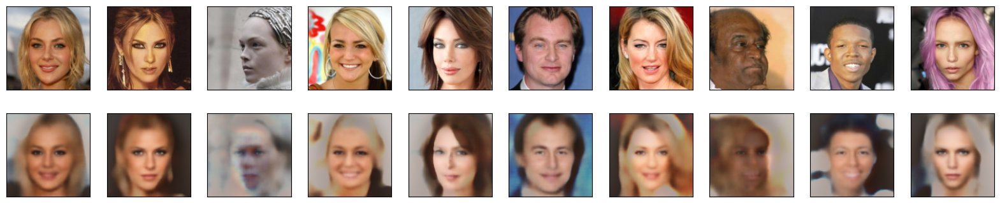

In [ ]:
# Test our proposed model using the linear increasing temperature from 0.1 to higher temp by 0.4 varying rate on CelebA HD
def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)

# Pass the images through the best model
recon_batch, _, _, _, _ = model(data)

# Plot the original and reconstructed images
plot_images(data.cpu(), recon_batch.cpu())


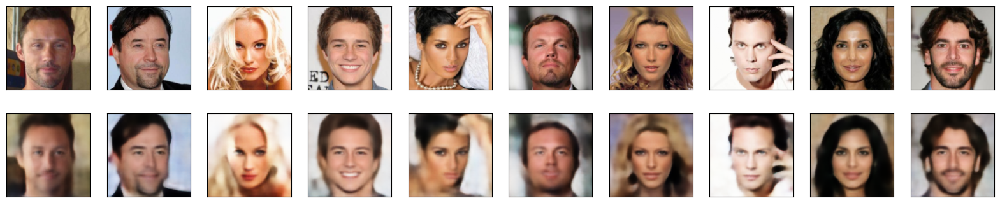

In [ ]:
# Test our proposed model using the linear increasing temperature from 0.1 to higher temp by 0.9 varying rate on CelebA HD
def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)

# Pass the images through the best model
recon_batch, _, _, _, _ = model1(data)

# Plot the original and reconstructed images
plot_images(data.cpu(), recon_batch.cpu())



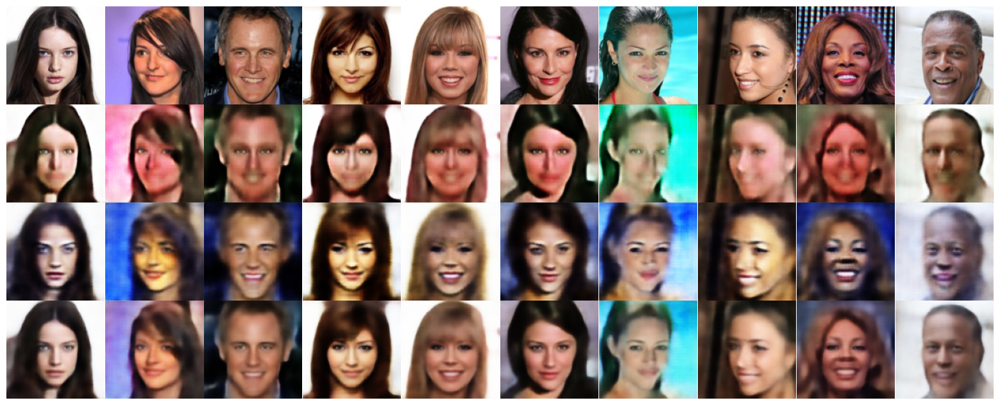

In [ ]:
# Test each layer's contribution of our proposed model using the linear increasing temperature from 0.1 to higher temp by 0.9 varying rate on CelebA HD
def plot_images_from_layers_and_reconstruction(data, model):
    with torch.no_grad():  # Ensure we're in no_grad mode when doing inference
        logits_z1, logits_z2 = model.encode(data)
        z1 = model.reparameterize(logits_z1, model.tau_1)
        z2 = model.reparameterize(logits_z2, model.tau_2)
        recon_images_layer1 = model.decode1(z1)
        recon_images_layer2 = model.decode2(z2)
        # Combine the layers to create the final reconstruction
        final_reconstruction = (recon_images_layer1 + recon_images_layer2) / 2.0

        # Plot images
        fig, axes = plt.subplots(4, 10, figsize=(20, 8))
        plt.subplots_adjust(wspace=0, hspace=0)  # Remove whitespace

        for i in range(10):
            # Original images
            axes[0, i].imshow(data[i].cpu().permute(1, 2, 0))
            axes[0, i].axis('off')
            # Reconstructed images from layer 1
            axes[1, i].imshow(recon_images_layer1[i].cpu().permute(1, 2, 0))
            axes[1, i].axis('off')
            # Reconstructed images from layer 2
            axes[2, i].imshow(recon_images_layer2[i].cpu().permute(1, 2, 0))
            axes[2, i].axis('off')
            # Final reconstructed images
            axes[3, i].imshow(final_reconstruction[i].cpu().permute(1, 2, 0))
            axes[3, i].axis('off')

        plt.show()


plot_images_from_layers_and_reconstruction(data, model1)


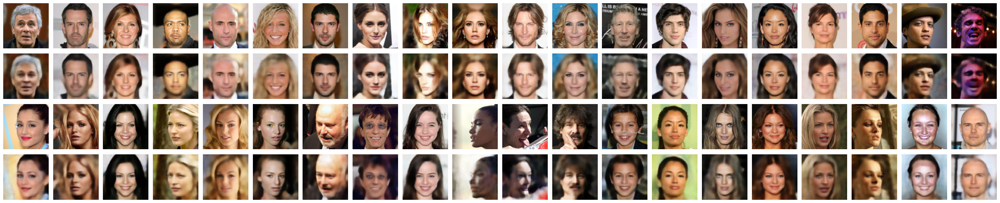

In [ ]:
# Test reconstruction of our proposed model using the linear increasing temperature from 0.1 to higher temp by 0.9 varying rate on CelebA HD
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms


# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])


test_loader = DataLoader(test_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


def plot_images(test_loader, model, device, rows=2, cols=20):
    # Get the first batch of images
    data_1, _ = next(iter(test_loader))
    data_1 = data_1.to(device)
    recon_batch_1, _, _, _, _ = model(data_1)

    # Get the second batch of images
    data_2, _ = next(iter(test_loader))
    data_2 = data_2.to(device)
    recon_batch_2, _, _, _, _  = model(data_2)

    # Convert to numpy arrays
    original_images_1 = data_1.cpu().numpy()
    reconstructed_images_1 = recon_batch_1.cpu().detach().numpy()
    original_images_2 = data_2.cpu().numpy()
    reconstructed_images_2 = recon_batch_2.cpu().detach().numpy()

    # Plotting
    fig, axes = plt.subplots(nrows=2 * rows, ncols=cols, figsize=(2 * cols, 4 * rows))
    for i in range(cols):
        # Display first set of original images in the first row
        axes[0, i].imshow(original_images_1[i].transpose(1, 2, 0))
        axes[0, i].axis('off')

        # Display first set of reconstructed images in the second row
        axes[1, i].imshow(reconstructed_images_1[i].transpose(1, 2, 0))
        axes[1, i].axis('off')

        # Display second set of original images in the third row
        axes[2, i].imshow(original_images_2[i].transpose(1, 2, 0))
        axes[2, i].axis('off')

        # Display second set of reconstructed images in the fourth row
        axes[3, i].imshow(reconstructed_images_2[i].transpose(1, 2, 0))
        axes[3, i].axis('off')

    plt.subplots_adjust(wspace=0.1, hspace=0.1)  # Adjust the spacing between images
    plt.show()

plot_images(test_loader, model1, device)


Files already downloaded and verified
Files already downloaded and verified


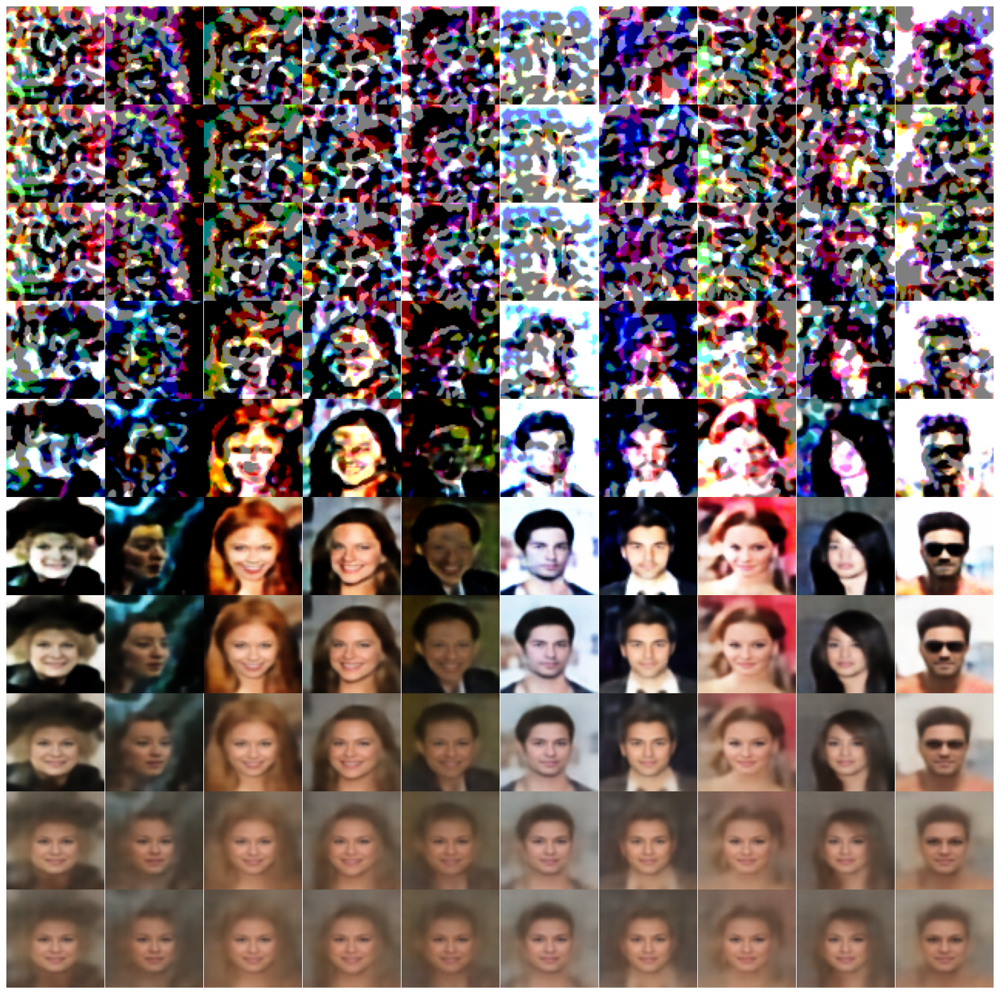

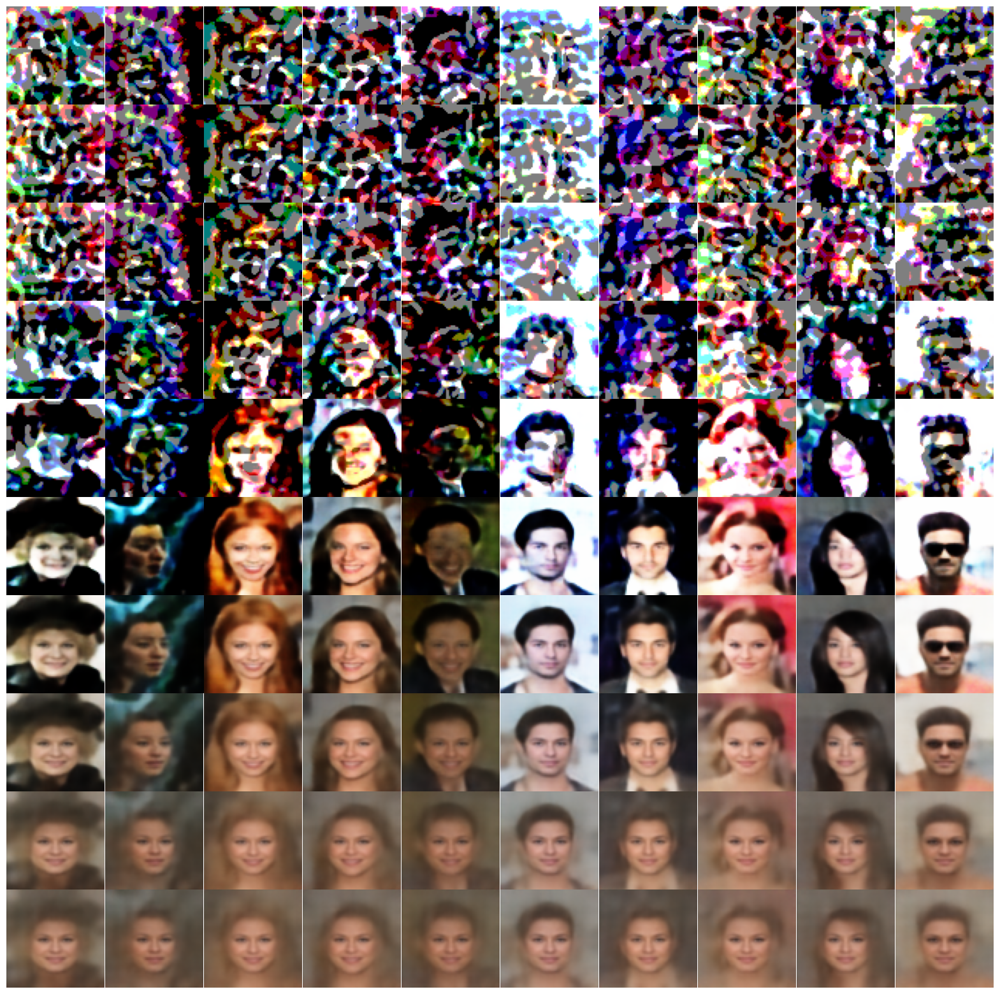

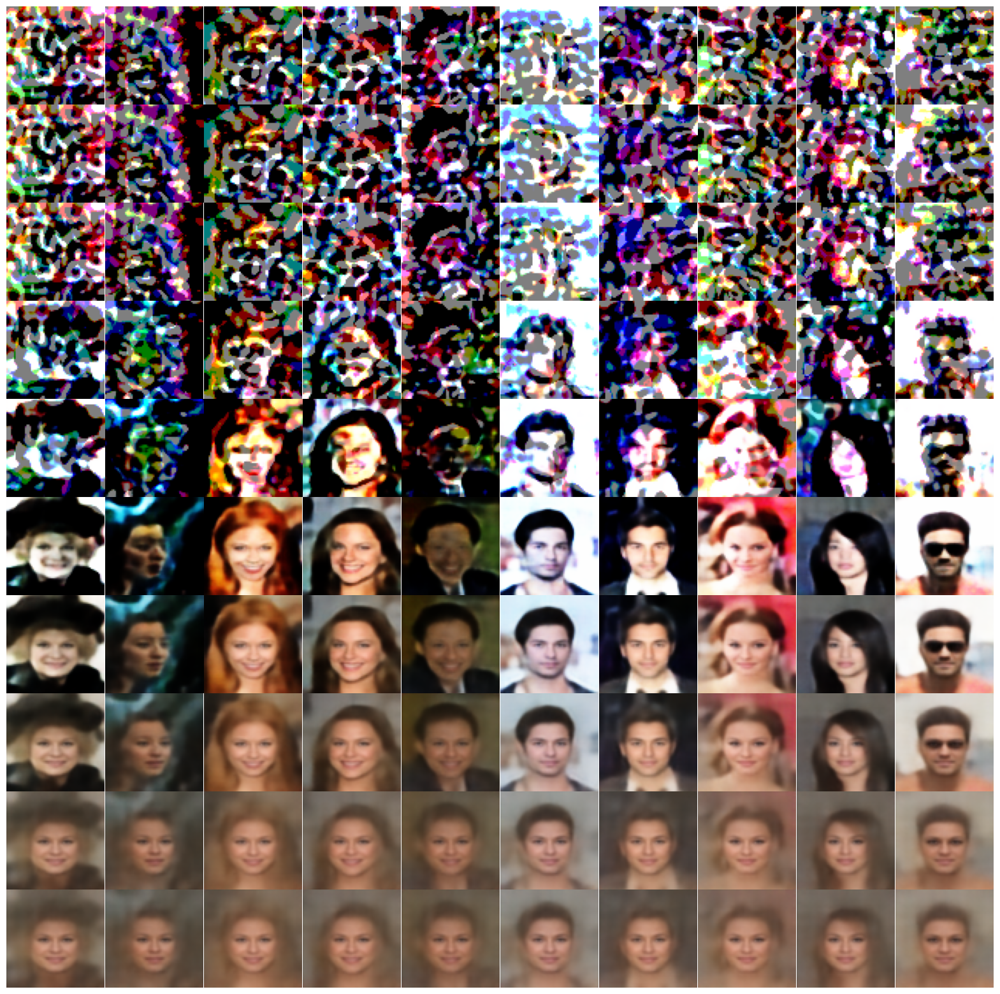

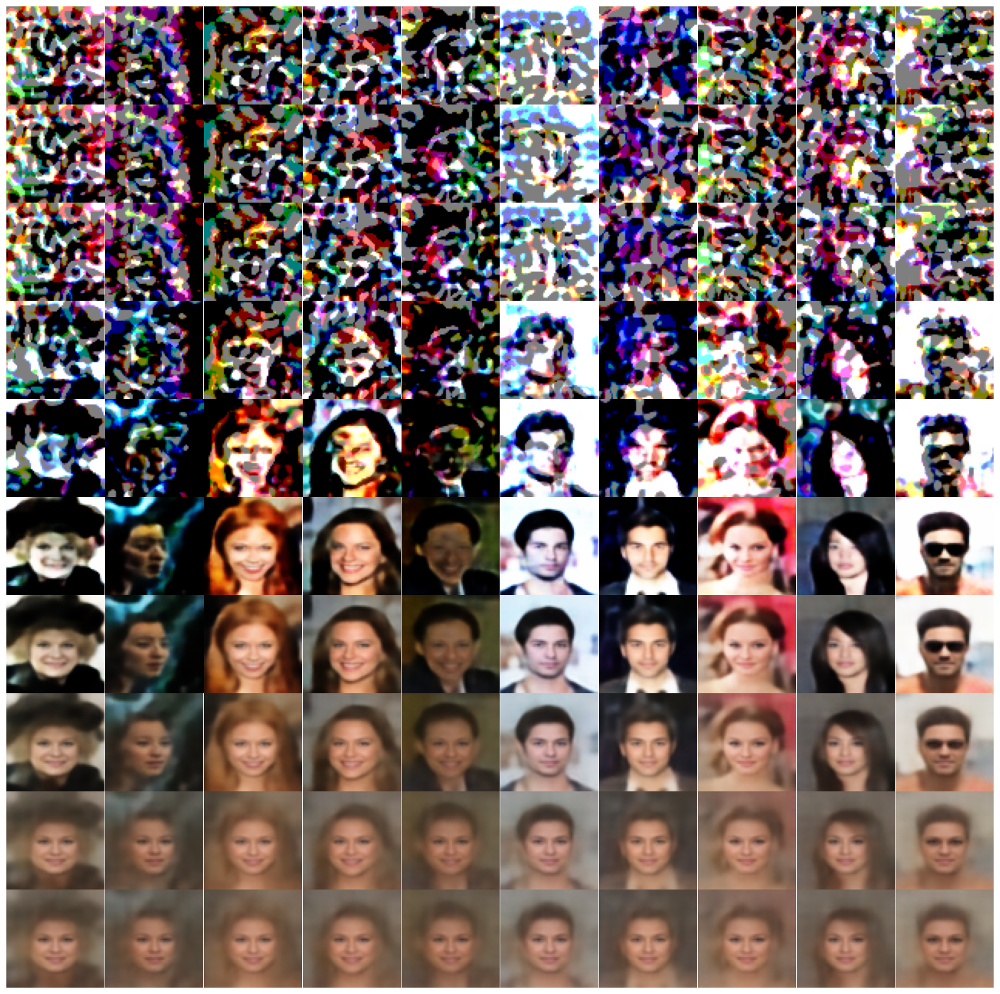

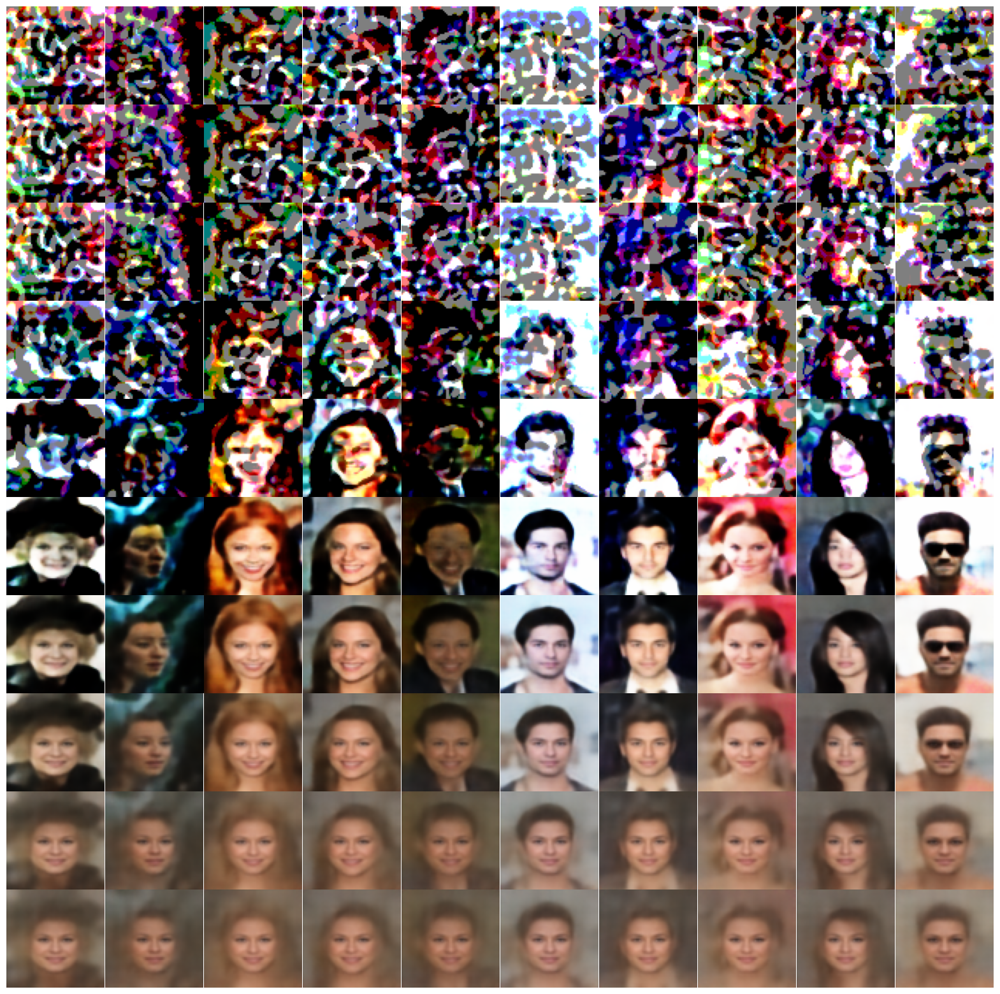

Exception ignored in: <function _after_fork at 0x7f12803c1b40>
Traceback (most recent call last):
  File "/usr/lib/python3.10/threading.py", line 1622, in _after_fork
    threads.update(_dangling)
  File "/usr/lib/python3.10/_weakrefset.py", line 66, in __iter__
    item = itemref()
KeyboardInterrupt: 


KeyboardInterrupt: 

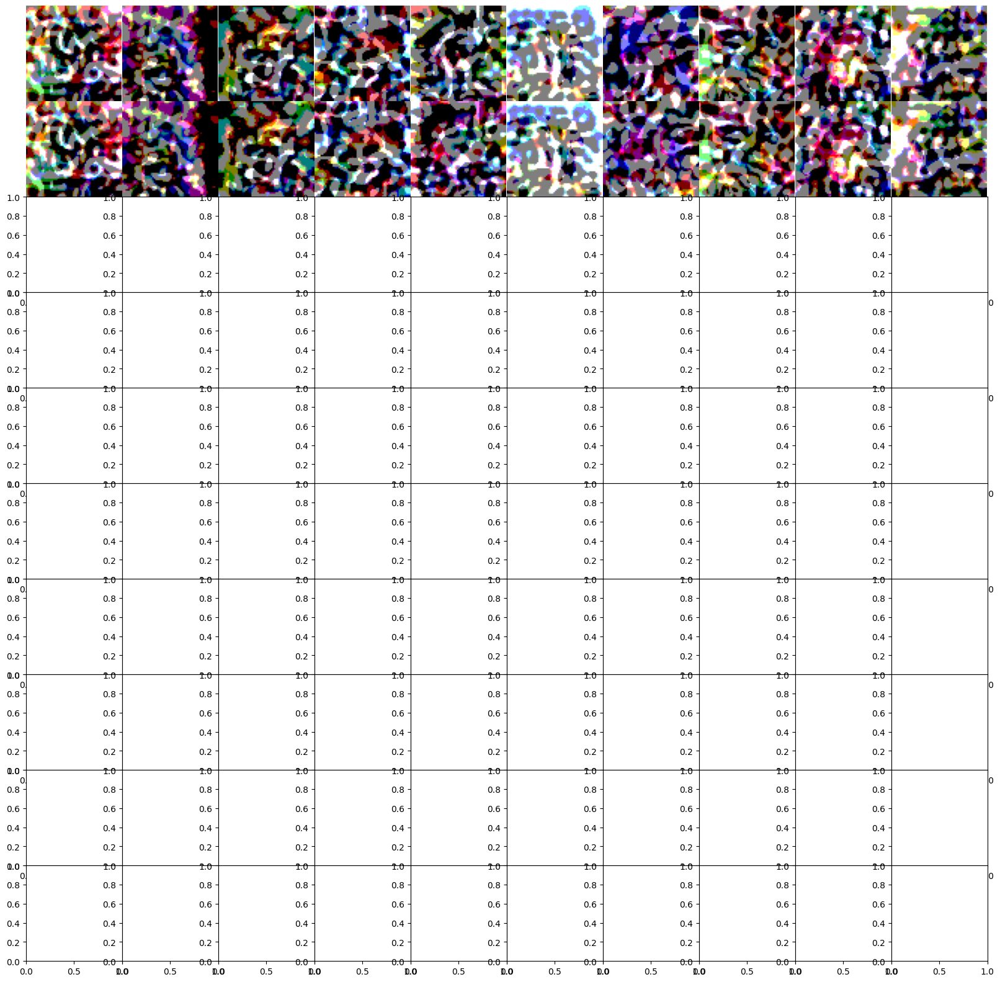

In [ ]:
# Test the impact of temperature τ on data generation on CelebA
import torch
import matplotlib.pyplot as plt
from torchvision import datasets, transforms

# Function to plot reconstructed images in one large figure
def plot_all_reconstructed_images(tau_values, test_loader, model, device, n=10):
    fig, axes = plt.subplots(len(tau_values), n, figsize=(20, 2 * len(tau_values)))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots

    for row, tau in enumerate(tau_values):
        model.tau_1 = tau
        model.tau_2 = tau
        data, _ = next(iter(test_loader))
        data = data.to(device)
        recon_batch, _, _, _, _ = model(data)
        reconstructed_images = recon_batch.cpu().detach().numpy()

        for col in range(n):
            ax = axes[row, col]
            ax.imshow(np.transpose(reconstructed_images[col], (1, 2, 0)))
            ax.axis('off')  # Hide axes

    plt.show()


# Load your GumbelSoftmaxVAE model
model = GumbelSoftmaxVAE()
state_dict = torch.load(SAVE_PATH, map_location=device)
state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)
model.load_state_dict(state_dict)
model.to(device)
model.eval()

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CelebA dataset
train_dataset = datasets.CelebA('./data', split='train', transform=transform, download=True)
test_dataset = datasets.CelebA('./data', split='test', transform=transform, download=True)

# Create data loaders
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


# Tau values to test
tau_values = [0.5, 0.9, 0.95, 5, 10, 30, 51.35, 90, 200, 300]

# Iterate over tau values, update model, and plot reconstructed images
for tau in tau_values:
    model.tau_1 = tau
    model.tau_2 = tau
    data, _ = next(iter(test_loader))
    data = data.to(device)
    recon_batch, _, _, _, _ = model(data)
    # Only plot reconstructed images
    plot_all_reconstructed_images(tau_values, test_loader, model, device)


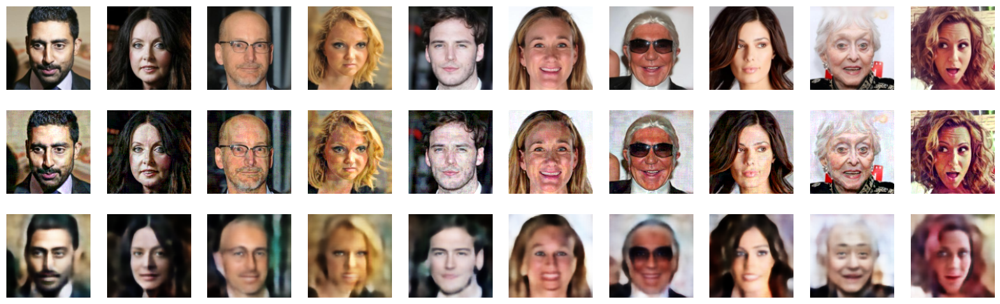

In [ ]:
# Test reconstruction of our proposed model under FGSM attack
# The model uses the linear increasing temperature from 0.1 to higher temp by 0.9 varying rate on CelebA HD
# Attack intensity is 0.05
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms

# Define the FGSM attack function
def fgsm_attack(image, epsilon, data_grad):
    sign_data_grad = data_grad.sign()
    perturbed_image = image + epsilon * sign_data_grad
    perturbed_image = torch.clamp(perturbed_image, 0, 1)
    return perturbed_image

# Epsilon value for the FGSM attack
epsilon = 0.05 # intensity of FGSM attack
best_model = model1
best_model.eval()

data, _ = next(iter(test_loader))
data = data.to(device)
data.requires_grad = True

# Forward pass
reconstructed_images = best_model(data)[0]
loss = F.mse_loss(reconstructed_images, data)

# Zero all existing gradients
best_model.zero_grad()

# Calculate gradients of model in backward pass
loss.backward()

# Collect the data gradients
data_grad = data.grad.data

# Call FGSM Attack
perturbed_data = fgsm_attack(data, epsilon, data_grad)

# Reconstruct images using the best model
recon_batch = best_model(perturbed_data)[0]

# Plot the original, adversarial, and reconstructed images
plt.figure(figsize=(20, 6))
for i in range(10):
    # Original images
    ax = plt.subplot(3, 10, i + 1)
    plt.imshow(data[i].cpu().detach().numpy().transpose(1, 2, 0))
    ax.axis('off')

    # Adversarial examples
    ax = plt.subplot(3, 10, i + 11)
    plt.imshow(perturbed_data[i].cpu().detach().numpy().transpose(1, 2, 0))
    ax.axis('off')

    # Reconstructed images
    ax = plt.subplot(3, 10, i + 21)
    plt.imshow(recon_batch[i].cpu().detach().numpy().transpose(1, 2, 0))
    ax.axis('off')

plt.show()

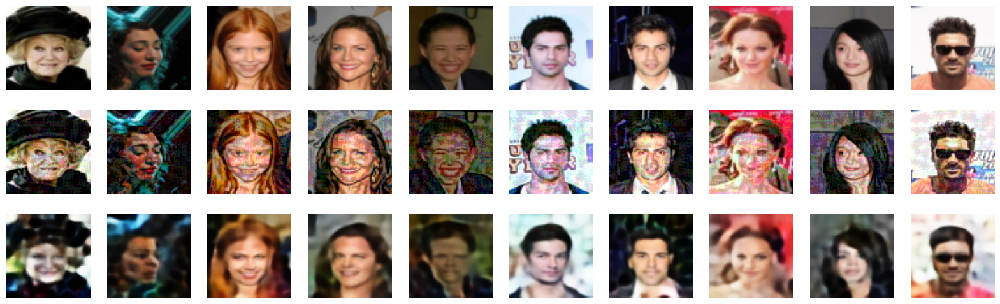

In [ ]:
# Test reconstruction of our proposed model under FGSM attack
# Attack intensity is 0.1
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms

# Define the FGSM attack function
def fgsm_attack(image, epsilon, data_grad):
    sign_data_grad = data_grad.sign()
    perturbed_image = image + epsilon * sign_data_grad
    perturbed_image = torch.clamp(perturbed_image, 0, 1)
    return perturbed_image

# Epsilon value for the FGSM attack
epsilon = 0.1

best_model = models[best_model_idx].to(device)
best_model.eval()

# Assuming test_loader is a DataLoader for the CelebA dataset
data, _ = next(iter(test_loader))
data = data.to(device)
data.requires_grad = True

# Forward pass
reconstructed_images = best_model(data)[0]
loss = F.mse_loss(reconstructed_images, data)

# Zero all existing gradients
best_model.zero_grad()

# Calculate gradients of model in backward pass
loss.backward()

# Collect the data gradients
data_grad = data.grad.data

# Call FGSM Attack
perturbed_data = fgsm_attack(data, epsilon, data_grad)
recon_batch = best_model(perturbed_data)[0]

# Plot the original, adversarial, and reconstructed images
plt.figure(figsize=(20, 6))
for i in range(10):
    # Original images
    ax = plt.subplot(3, 10, i + 1)
    plt.imshow(data[i].cpu().detach().numpy().transpose(1, 2, 0))
    ax.axis('off')

    # Adversarial examples
    ax = plt.subplot(3, 10, i + 11)
    plt.imshow(perturbed_data[i].cpu().detach().numpy().transpose(1, 2, 0))
    ax.axis('off')

    # Reconstructed images
    ax = plt.subplot(3, 10, i + 21)
    plt.imshow(recon_batch[i].cpu().detach().numpy().transpose(1, 2, 0))
    ax.axis('off')

plt.show()



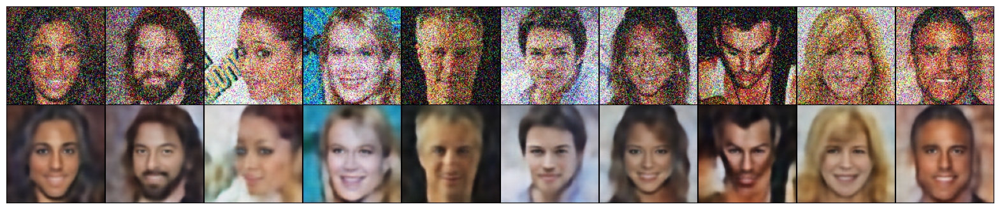

MSE between original and reconstructed images: 0.007447692099958658


In [ ]:
# Test reconstruction of our proposed model under Gaussian noise attack std = 0.3
# The model uses the linear increasing temperature from 0.1 to higher temp by 0.9 varying rate on CelebA HD
import numpy as np
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
import torch.nn.functional as F

# Function to add Gaussian noise to images
def add_gaussian_noise(images, mean=0.0, std=0.3):
    noise = np.random.normal(mean, std, images.shape)
    noisy_images = images + noise
    return np.clip(noisy_images, 0, 1)

def plot_images(noisy_images, reconstructed_images, n=10):
    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display noisy images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstructed images
        ax = plt.subplot(2, n, i + n + 1)
        plt.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to calculate MSE between original and reconstructed images
def calculate_mse(original, reconstructed):
    return F.mse_loss(torch.tensor(original), torch.tensor(reconstructed))

data, _ = next(iter(test_loader))
data = data.to(device)

# Generate noisy images
noisy_data = add_gaussian_noise(data.cpu().numpy())
noisy_data_tensor = torch.tensor(noisy_data).float().to(device)
recon_batch, _, _, _, _ = model1(noisy_data_tensor)

# Plot noisy and reconstructed images
plot_images(noisy_data, recon_batch.cpu().detach().numpy(), n=10)

# Calculate and print MSE
mse_value = calculate_mse(data.cpu().numpy(), recon_batch.cpu().detach().numpy())
print(f"MSE between original and reconstructed images: {mse_value.item()}")


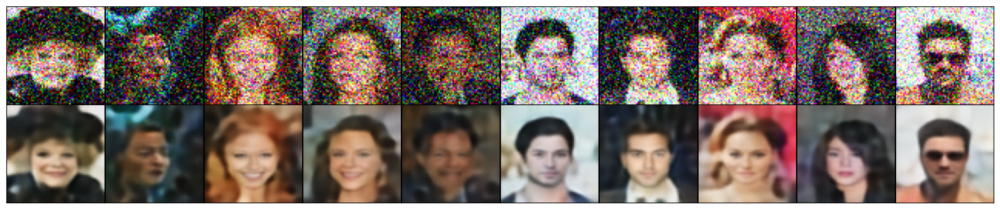

MSE between original and reconstructed images: 0.007811245042830706


In [ ]:
# Test reconstruction of our proposed model under Gaussian noise attack std = 0.4
import numpy as np
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
import torch.nn.functional as F

# Function to add Gaussian noise to images
def add_gaussian_noise(images, mean=0.0, std=0.4):
    noise = np.random.normal(mean, std, images.shape)
    noisy_images = images + noise
    return np.clip(noisy_images, 0, 1)

# Function to plot two rows of images without white spaces
def plot_images(noisy_images, reconstructed_images, n=10):
    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display noisy images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstructed images
        ax = plt.subplot(2, n, i + n + 1)
        plt.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

def calculate_mse(original, reconstructed):
    return F.mse_loss(torch.tensor(original), torch.tensor(reconstructed))

data, _ = next(iter(test_loader))
data = data.to(device)

noisy_data = add_gaussian_noise(data.cpu().numpy())
noisy_data_tensor = torch.tensor(noisy_data).float().to(device)

recon_batch, _, _, _, _ = models[best_model_idx](noisy_data_tensor)

# Plot noisy and reconstructed images
plot_images(noisy_data, recon_batch.cpu().detach().numpy(), n=10)

# Calculate and print MSE
mse_value = calculate_mse(data.cpu().numpy(), recon_batch.cpu().detach().numpy())
print(f"MSE between original and reconstructed images: {mse_value.item()}")


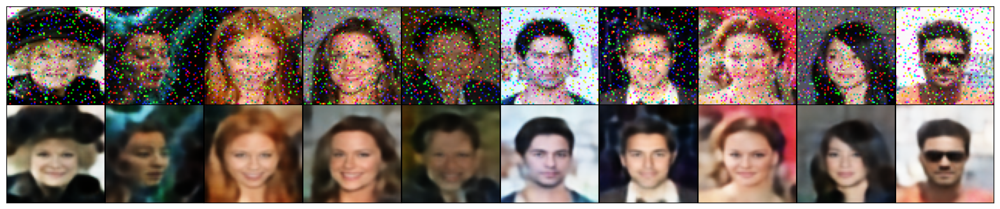

MSE between original and reconstructed images: 0.004961900878697634


In [ ]:
# Test reconstruction of our proposed model under S&P attack amount = 0.4
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
from skimage.util import random_noise
import torch.nn.functional as F

# Function to plot two rows of images without white spaces
def plot_images(noisy_images, reconstructed_images, n=10):
    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display noisy images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstructed images
        ax = plt.subplot(2, n, i + n + 1)
        plt.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to calculate MSE between original and reconstructed images
def calculate_mse(original, reconstructed):
    return F.mse_loss(torch.tensor(original), torch.tensor(reconstructed))

# Add salt and pepper noise and reconstruct
original_images = data.cpu().numpy()
noisy_images = random_noise(original_images, mode="s&p", amount=0.1)
noisy_data_tensor = torch.tensor(noisy_images, dtype=torch.float32).to(device)

with torch.no_grad():
    recon_noisy_batch = best_model(noisy_data_tensor)[0]

plot_images(noisy_images, recon_noisy_batch.cpu().numpy(), n=10)

# Calculate and print MSE
mse_value = calculate_mse(original_images, recon_noisy_batch.cpu().numpy())
print(f"MSE between original and reconstructed images: {mse_value.item()}")


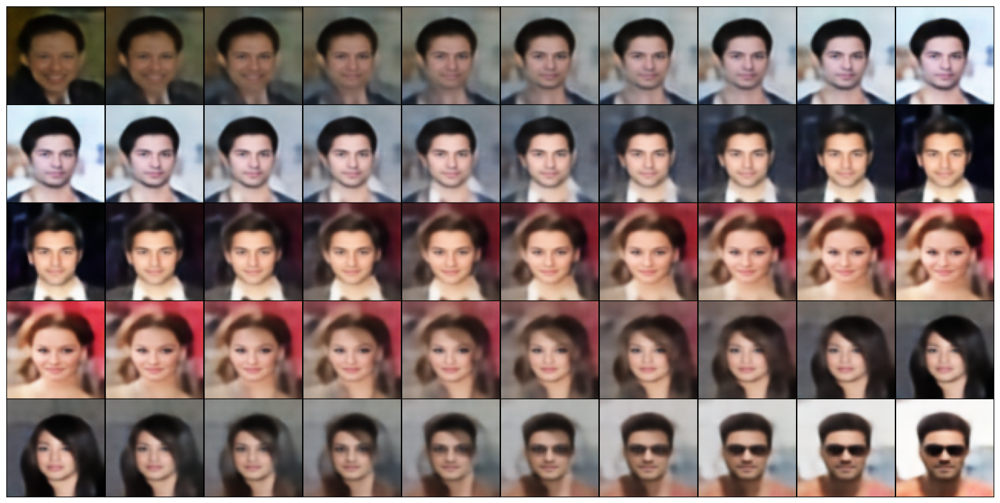

In [ ]:
# Test interpolated images of our proposed model
import torch
import matplotlib.pyplot as plt

# Function to plot images in rows as a single figure
def plot_interpolated_images(images_list):
    num_rows = len(images_list)
    num_cols = len(images_list[0])
    plt.figure(figsize=(2 * num_cols, 2 * num_rows))
    for row, images in enumerate(images_list):
        for col, image in enumerate(images):
            ax = plt.subplot(num_rows, num_cols, row * num_cols + col + 1)
            plt.imshow(image.transpose(1, 2, 0))
            ax.get_xaxis().set_visible(False)
            ax.get_yaxis().set_visible(False)
    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()

# Function to interpolate between two images
def interpolate_images(image1, image2, steps=10):
    interpolated_images = []
    for alpha in torch.linspace(0, 1, steps):
        interpolated_image = (1 - alpha) * image1 + alpha * image2
        interpolated_images.append(interpolated_image.unsqueeze(0))
    return torch.cat(interpolated_images, dim=0)

data, _ = next(iter(test_loader))
data = data.to(device)
selected_data = data[4:10]

# Interpolate between each pair of selected images
interpolated_data_list = []
for i in range(len(selected_data) - 1):
    interpolated_data = interpolate_images(selected_data[i], selected_data[i + 1])
    with torch.no_grad():
        recon_interpolated = models[best_model_idx](interpolated_data)[0]
    interpolated_data_list.append(recon_interpolated.cpu().numpy())

# Plot the interpolated images
plot_interpolated_images(interpolated_data_list)

In [ ]:
# Test GS-VAE using linear increasing temperature strategy compared to the one using exponential decay strategy on CelebA
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import os
import random
from PIL import Image
import zipfile


# Set the random seed and device
SEED = 1
torch.manual_seed(SEED)
cuda = torch.cuda.is_available()
device = torch.device('cuda' if cuda else 'cpu')


# Define constants
BATCH_SIZE = 128
Z_DIM = 300
NUM_EPOCHS = 100
LOG_INTERVAL = 50
SAVE_PATH = "model.pth"
DATA_DIR = "/content/sample_data/archive.zip"


class CustomDataset(Dataset):
    def __init__(self, root_zip, transform=None):
        self.root_zip = root_zip
        self.transform = transform
        self.image_paths = self.extract_zip(root_zip)
        random.shuffle(self.image_paths)  # Shuffle the image paths

    def extract_zip(self, root_zip):
        # Extract the ZIP file
        extract_dir = '/content/extracted_images'  # Main directory where the zip is extracted
        sub_dir = 'celeba_hq_256'  # Subdirectory containing the images
        full_extract_dir = os.path.join(extract_dir, sub_dir)  # Full path to the images
        with zipfile.ZipFile(root_zip, 'r') as zip_ref:
            zip_ref.extractall(extract_dir)

        # List image files in the subdirectory
        image_paths = [os.path.join(full_extract_dir, filename)
                       for filename in os.listdir(full_extract_dir)
                       if os.path.isfile(os.path.join(full_extract_dir, filename))]
        return image_paths

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_name = self.image_paths[idx]
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, 0

# Define the directory containing the ZIP file
DATA_DIR = '/content/sample_data/archive.zip'

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])

# Create a custom dataset
custom_dataset = CustomDataset(DATA_DIR, transform=transform)


total_size = len(custom_dataset)
train_size = int(0.8 * total_size)
test_size = total_size - train_size

train_dataset, test_dataset = torch.utils.data.random_split(custom_dataset, [train_size, test_size])
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)

# Define a simple GS-VAE model only includes one latent layer
class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau=1.0):
        super().__init__()
        self.tau = tau

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1),  # 64x64
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1),  # 32x32
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),  # 16x16
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),  # 8x8
            nn.ReLU(),
            nn.Flatten(),
        )
        self.fc1 = nn.Linear(256 * 8 * 8, Z_DIM)

        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(Z_DIM, 256 * 8 * 8),
            nn.Unflatten(1, (256, 8, 8)),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 16x16
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # 32x32
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),  # 64x64
            nn.ReLU(),
            nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1),  # 128x128
            nn.Sigmoid()
        )

    def reparameterize(self, logits):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / self.tau
        z = F.softmax(z, dim=-1)
        return z

    def forward(self, x):
        x = self.encoder(x)
        logits_z = self.fc1(x)
        z = self.reparameterize(logits_z)
        x_hat = self.decoder(z)
        return x_hat, logits_z, z

    def loss_function(self, recon_x, x, logits_z, z):
        recon_x = torch.clamp(recon_x, 0, 1)
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        p_z = F.softmax(logits_z, dim=-1)
        p_z = torch.clamp(p_z, torch.finfo(p_z.dtype).eps, 1. - torch.finfo(p_z.dtype).eps)
        kl_loss = torch.sum(p_z * torch.log(p_z * Z_DIM + torch.finfo(p_z.dtype).eps), dim=-1)

        vae_loss = torch.mean(xent_loss + kl_loss)
        return vae_loss

In [ ]:
# Train the GS-VAE using linear increasing temperature strategy compared to the one using exponential decay strategy on CelebA
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torchvision import datasets, transforms
import matplotlib.pyplot as plt
import numpy as np
import copy
from PIL import Image

model = GumbelSoftmaxVAE().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)


NUM_EPOCHS = 150
initial_tau = 1.0
decay_rate = 0.995

# Training loop
best_test_loss = float('inf')
for epoch in range(NUM_EPOCHS):
    model.train()
    train_loss = 0.0

    # Update the tau value
    model.tau = max(initial_tau * (decay_rate * epoch), 0.1) # linear increasing the temperature by 0.995 plus each epoch

    for batch_idx, (data, _) in enumerate(train_loader):
        data = data.to(device)
        optimizer.zero_grad()
        recon_batch, logits_z, z = model(data)
        loss = model.loss_function(recon_batch, data, logits_z, z)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()

        if batch_idx % LOG_INTERVAL == 0:
            print(f'Train Epoch: {epoch} [{batch_idx * len(data)}/{len(train_loader.dataset)} ({100. * batch_idx / len(train_loader):.0f}%)]\tLoss: {loss.item() / len(data):.6f}')

    print(f'====> Epoch: {epoch} Average loss: {train_loss / len(train_loader.dataset):.4f}')

    # Validate the model
    model.eval()
    test_loss = 0
    with torch.no_grad():
        for data, _ in test_loader:
            data = data.to(device)
            recon_batch, logits_z, z = model(data)
            test_loss += model.loss_function(recon_batch, data, logits_z, z).item()

    test_loss /= len(test_loader.dataset)
    print(f'====> Test set loss: {test_loss:.4f}')

    # Save the model if it's the best so far
    if test_loss < best_test_loss:
        best_test_loss = test_loss
        torch.save(model.state_dict(), SAVE_PATH)

print("Training complete. Model saved to", SAVE_PATH)

Train Epoch: 0 [0/24000 (0%)]	Loss: 264.598694
Train Epoch: 0 [6400/24000 (27%)]	Loss: 257.363495
Train Epoch: 0 [12800/24000 (53%)]	Loss: 244.071655
Train Epoch: 0 [19200/24000 (80%)]	Loss: 240.364380
====> Epoch: 0 Average loss: 248.2705
====> Test set loss: 236.4245
Train Epoch: 1 [0/24000 (0%)]	Loss: 240.035706
Train Epoch: 1 [6400/24000 (27%)]	Loss: 231.153290
Train Epoch: 1 [12800/24000 (53%)]	Loss: 229.283478
Train Epoch: 1 [19200/24000 (80%)]	Loss: 225.956360
====> Epoch: 1 Average loss: 228.8833
====> Test set loss: 224.5419
Train Epoch: 2 [0/24000 (0%)]	Loss: 221.754181
Train Epoch: 2 [6400/24000 (27%)]	Loss: 216.532532
Train Epoch: 2 [12800/24000 (53%)]	Loss: 214.957626
Train Epoch: 2 [19200/24000 (80%)]	Loss: 216.018677
====> Epoch: 2 Average loss: 217.8199
====> Test set loss: 214.4848
Train Epoch: 3 [0/24000 (0%)]	Loss: 212.050568
Train Epoch: 3 [6400/24000 (27%)]	Loss: 209.259064
Train Epoch: 3 [12800/24000 (53%)]	Loss: 208.452637
Train Epoch: 3 [19200/24000 (80%)]	Loss:

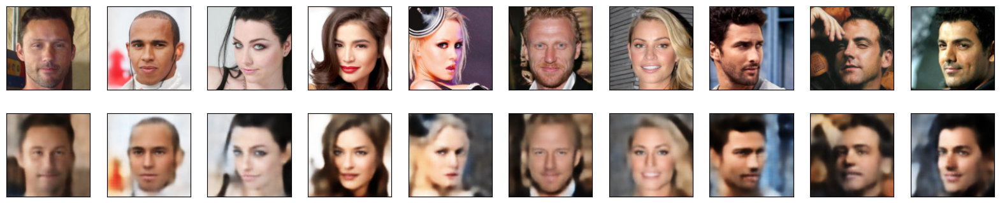

In [ ]:
# Test the GS-VAE using linear increasing temperature strategy compared to the one using exponential decay strategy on CelebA
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms

def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])


test_loader = DataLoader(test_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
# Pass the images through the model
SAVE_PATH = "/content/model.pth"

# Load the model
model.load_state_dict(torch.load(SAVE_PATH, map_location=device))
model.to(device)
model.eval()

# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)

# Pass the images through the model
recon_batch, _, _ = model(data)

# Plot the original and reconstructed images
plot_images(data.cpu(), recon_batch.cpu(), n=10)


In [ ]:
# Test GS-VAE using exponential decay temperature strategy on CelebA
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import os
import random
from PIL import Image
import zipfile


# Set the random seed and device
SEED = 1
torch.manual_seed(SEED)
cuda = torch.cuda.is_available()
device = torch.device('cuda' if cuda else 'cpu')


# Define constants
BATCH_SIZE = 128
Z_DIM = 300
NUM_EPOCHS = 20
LOG_INTERVAL = 50
SAVE_PATH = "model.pth"
DATA_DIR = "/content/sample_data/archive.zip"


class CustomDataset(Dataset):
    def __init__(self, root_zip, transform=None):
        self.root_zip = root_zip
        self.transform = transform
        self.image_paths = self.extract_zip(root_zip)
        random.shuffle(self.image_paths)  # Shuffle the image paths

    def extract_zip(self, root_zip):
        # Extract the ZIP file
        extract_dir = '/content/extracted_images'  # Main directory where the zip is extracted
        sub_dir = 'celeba_hq_256'  # Subdirectory containing the images
        full_extract_dir = os.path.join(extract_dir, sub_dir)  # Full path to the images
        with zipfile.ZipFile(root_zip, 'r') as zip_ref:
            zip_ref.extractall(extract_dir)

        # List image files in the subdirectory
        image_paths = [os.path.join(full_extract_dir, filename)
                       for filename in os.listdir(full_extract_dir)
                       if os.path.isfile(os.path.join(full_extract_dir, filename))]
        return image_paths

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_name = self.image_paths[idx]
        image = Image.open(img_name).convert('RGB')
        if self.transform:
            image = self.transform(image)
        return image, 0

# Define the directory containing the ZIP file
DATA_DIR = '/content/sample_data/archive.zip'

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])

# Create a custom dataset
custom_dataset = CustomDataset(DATA_DIR, transform=transform)


total_size = len(custom_dataset)
train_size = int(0.8 * total_size)
test_size = total_size - train_size

train_dataset, test_dataset = torch.utils.data.random_split(custom_dataset, [train_size, test_size])


train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau=1.0):
        super().__init__()
        self.tau = tau

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1),  # 64x64
            nn.ReLU(),
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1),  # 32x32
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1),  # 16x16
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1),  # 8x8
            nn.ReLU(),
            nn.Flatten(),
        )
        self.fc1 = nn.Linear(256 * 8 * 8, Z_DIM)

        # Decoder
        self.decoder = nn.Sequential(
            nn.Linear(Z_DIM, 256 * 8 * 8),
            nn.Unflatten(1, (256, 8, 8)),
            nn.ReLU(),
            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),  # 16x16
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),  # 32x32
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),  # 64x64
            nn.ReLU(),
            nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1),  # 128x128
            nn.Sigmoid()
        )

    def reparameterize(self, logits):
        gumbel_noise = torch.rand_like(logits)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / self.tau
        z = F.softmax(z, dim=-1)
        return z

    def forward(self, x):
        x = self.encoder(x)
        logits_z = self.fc1(x)
        z = self.reparameterize(logits_z)
        x_hat = self.decoder(z)
        return x_hat, logits_z, z


    def loss_function(self, recon_x, x, logits_z, z, tau):
        # Calculate the reconstruction loss as the sum of MSE over all dimensions
        recon_loss = F.mse_loss(recon_x, x, reduction='none')
        recon_loss = torch.sum(recon_loss, dim=[1, 2, 3])

        # Weight for the reconstruction loss
        weight = 0.99
        recon_loss = weight * recon_loss
        p_z = F.softmax(logits_z, dim=-1)
        entropy = -torch.sum(p_z * torch.log(p_z + 1e-8), dim=1)
        cross_entropy = -torch.sum(z * torch.log(p_z + 1e-8), dim=1)
        kl_div = cross_entropy - entropy
        tau_reg = torch.mean(entropy) / tau

        # Combine the reconstruction loss, KL divergence, and tau regularization
        total_loss = torch.mean(recon_loss + kl_div - tau_reg)

        return total_loss


model = GumbelSoftmaxVAE().to(device)
optimizer = optim.Adam(model.parameters(), lr=1e-3)


initial_tau = 1.0
decay_rate = 0.995

# Training loop
best_test_loss = float('inf')
for epoch in range(NUM_EPOCHS):
    model.train()
    train_loss = 0.0

    # Update the tau value
    tau_value = max(initial_tau * (decay_rate ** epoch), 0.1)
    model.tau = tau_value  # Ensure that model's tau is updated

    for batch_idx, (data, _) in enumerate(train_loader):
        data = data.to(device)
        optimizer.zero_grad()
        recon_batch, logits_z, z = model(data)
        # Pass the current tau value to the loss function
        loss = model.loss_function(recon_batch, data, logits_z, z, tau_value)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()

        if batch_idx % LOG_INTERVAL == 0:
            print(f'Train Epoch: {epoch} [{batch_idx * len(data)}/{len(train_loader.dataset)} ({100. * batch_idx / len(train_loader):.0f}%)]\tLoss: {loss.item() / len(data):.6f}')

    print(f'====> Epoch: {epoch} Average loss: {train_loss / len(train_loader.dataset):.4f}')

    # Validate the model
    model.eval()
    test_loss = 0
    with torch.no_grad():
        for data, _ in test_loader:
            data = data.to(device)
            recon_batch, logits_z, z = model(data)
            # During validation, we do not pass the tau value since we do not need the tau regularization
            test_loss += model.loss_function(recon_batch, data, logits_z, z, tau_value).item()

    test_loss /= len(test_loader.dataset)
    print(f'====> Test set loss: {test_loss:.4f}')

    # Save the model if it's the best so far
    if test_loss < best_test_loss:
        best_test_loss = test_loss
        torch.save(model.state_dict(), SAVE_PATH)

print("Training complete. Model saved to", SAVE_PATH)



Train Epoch: 0 [0/24000 (0%)]	Loss: 30.753975
Train Epoch: 0 [6400/24000 (27%)]	Loss: 22.016960
Train Epoch: 0 [12800/24000 (53%)]	Loss: 18.354286
Train Epoch: 0 [19200/24000 (80%)]	Loss: 14.630905
====> Epoch: 0 Average loss: 20.6167
====> Test set loss: 14.4673
Train Epoch: 1 [0/24000 (0%)]	Loss: 14.672861
Train Epoch: 1 [6400/24000 (27%)]	Loss: 13.382835
Train Epoch: 1 [12800/24000 (53%)]	Loss: 13.914641
Train Epoch: 1 [19200/24000 (80%)]	Loss: 13.759002
====> Epoch: 1 Average loss: 13.5560
====> Test set loss: 12.9422
Train Epoch: 2 [0/24000 (0%)]	Loss: 12.622217
Train Epoch: 2 [6400/24000 (27%)]	Loss: 12.372560
Train Epoch: 2 [12800/24000 (53%)]	Loss: 12.587610
Train Epoch: 2 [19200/24000 (80%)]	Loss: 12.822136
====> Epoch: 2 Average loss: 12.6030
====> Test set loss: 12.3118
Train Epoch: 3 [0/24000 (0%)]	Loss: 12.848200
Train Epoch: 3 [6400/24000 (27%)]	Loss: 11.713198
Train Epoch: 3 [12800/24000 (53%)]	Loss: 11.925853
Train Epoch: 3 [19200/24000 (80%)]	Loss: 11.542315
====> Epoc

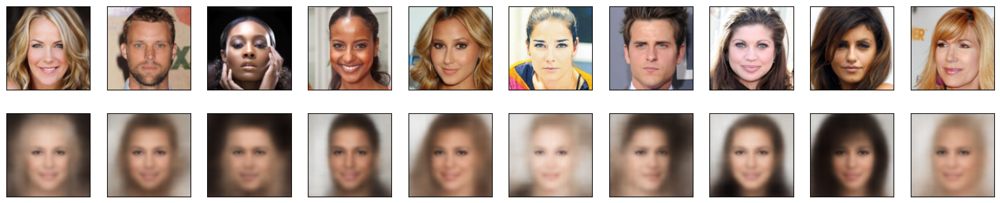

In [ ]:
# Test the GS-VAE using exponential decay strategy on CelebA
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms

def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((128, 128)),
    transforms.ToTensor()
])


test_loader = DataLoader(test_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
#test_loader = DataLoader(test_dataset, shuffle=True, batch_size=10, num_workers=4, pin_memory=True)
# Pass the images through the model
SAVE_PATH = "/content/model.pth"

# Load the model
model.load_state_dict(torch.load(SAVE_PATH, map_location=device))
model.to(device)
model.eval()

# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)

# Pass the images through the model
recon_batch, _, _ = model(data)

# Plot the original and reconstructed images
plot_images(data.cpu(), recon_batch.cpu(), n=10)
